In [1]:
%load_ext autoreload
%autoreload 2

import pymc as pm
import seaborn as sns
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import arviz as az
from matplotlib import pyplot as plt

import sys
sys.path.append('..')
from pfas_prep import PFAS
from PyPKMC import PyPKMC
import register_pfas_data as rpd

In [2]:
chemical = 'PFHxS'
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')#, hero_only=1289834) # 
Vdss_prior = {'mu': -1.5, 'sd': 1.5}
CLC_prior = {'mu': -2.89, 'sd': 2.68}
load_trace = True

# Rat fits

## Male

First import the data using the old PFAS class

In [3]:
%%time
pfas_male_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='rat')
pfas_male_data.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
dropping duplicated column
Hero ID used:  [1289834 3749289 4239569 5387170]
CPU times: user 626 ms, sys: 4.06 ms, total: 630 ms
Wall time: 631 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,11,-1,4,-1.0,NaN,0.299943,NaN,rat,sprague-dawley,10.0,mg/kg,1.0,day,61.540470,0.0,1,ug/ml,iv,serum,Male,DTXSID7040150,Figure 5,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,1.0,10.0,64.0,0.299943,61.540470,0.0,0.0,-1,0,0,0,0.0,4.119695,0.0,False,2.999429,1289834-10.0 mg/kg-iv
1,1289834,11,-1,4,-1.0,NaN,0.299943,NaN,rat,sprague-dawley,10.0,mg/kg,3.0,day,35.221932,0.0,1,ug/ml,iv,serum,Male,DTXSID7040150,Figure 5,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,3.0,10.0,66.0,0.307029,35.221932,0.0,0.0,-1,0,0,0,0.0,3.561669,0.0,False,2.999429,1289834-10.0 mg/kg-iv
2,1289834,11,-1,4,-1.0,NaN,0.299943,NaN,rat,sprague-dawley,10.0,mg/kg,9.0,day,28.550914,0.0,1,ug/ml,iv,serum,Male,DTXSID7040150,Figure 5,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,9.0,10.0,72.0,0.326943,28.550914,0.0,0.0,-1,0,0,0,0.0,3.351689,0.0,False,2.999429,1289834-10.0 mg/kg-iv
3,1289834,11,-1,4,-1.0,NaN,0.299943,NaN,rat,sprague-dawley,10.0,mg/kg,16.0,day,22.428198,0.0,1,ug/ml,iv,serum,Male,DTXSID7040150,Figure 5,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,16.0,10.0,79.0,0.345729,22.428198,0.0,0.0,-1,0,0,0,0.0,3.110319,0.0,False,2.999429,1289834-10.0 mg/kg-iv
4,1289834,11,-1,4,-1.0,NaN,0.299943,NaN,rat,sprague-dawley,10.0,mg/kg,23.0,day,20.509138,0.0,1,ug/ml,iv,serum,Male,DTXSID7040150,Figure 5,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,0,0,0,23.0,10.0,86.0,0.361800,20.509138,0.0,0.0,-1,0,0,0,0.0,3.020871,0.0,False,2.999429,1289834-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [4]:
pfas_male_1cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_rat_1cmpt
hierarchical model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


In [5]:
pfas_male_1cmpt.iv_oral_codes

['3749289-4.0 mg/kg-iv',
 '3749289-4.0 mg/kg-gavage',
 '4239569-10.0 mg/kg-iv',
 '4239569-10.0 mg/kg-gavage',
 '5387170-4.0 mg/kg-iv',
 '5387170-4.0 mg/kg-gavage']

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


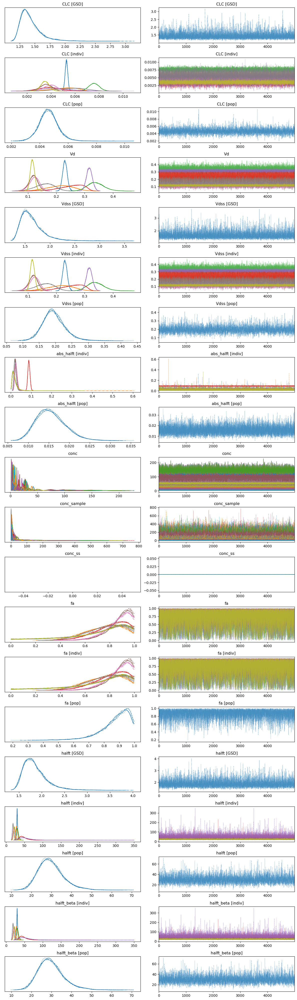

In [6]:
with pfas_male_1cmpt.model:
    az.plot_trace(pfas_male_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


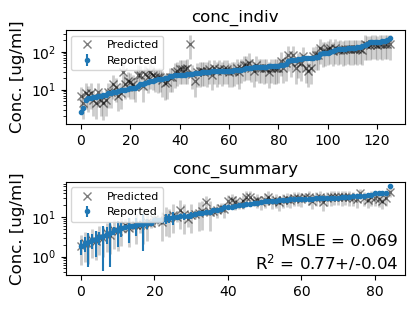

In [7]:
pfas_male_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [8]:
pfas_male_2cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro', # 0.1
                   load_trace=load_trace, tune=15000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_rat_2cmpt
hierarchical model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


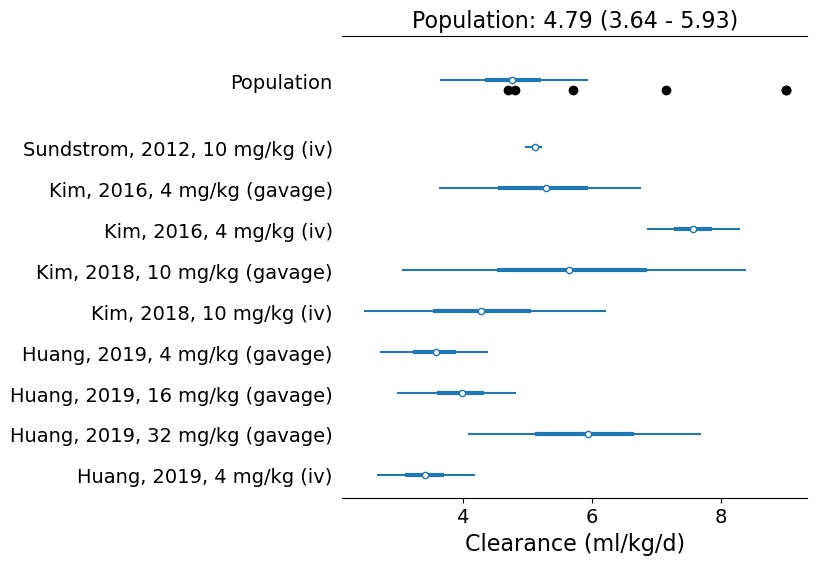

In [9]:
mapper = {'5387170-4.0 mg/kg-gavage': 'Huang, 2019, 4 mg/kg (gavage)',
          '5387170-16.0 mg/kg-gavage': 'Huang, 2019, 16 mg/kg (gavage)',
          '5387170-32.0 mg/kg-gavage': 'Huang, 2019, 32 mg/kg (gavage)',
          '5387170-4.0 mg/kg-iv':'Huang, 2019, 4 mg/kg (iv)',
          '4239569-10.0 mg/kg-gavage': 'Kim, 2018, 10 mg/kg (gavage)',
          '4239569-10.0 mg/kg-iv': 'Kim, 2018, 10 mg/kg (iv)',
          '3749289-4.0 mg/kg-gavage': 'Kim, 2016, 4 mg/kg (gavage)',
          '3749289-4.0 mg/kg-iv':'Kim, 2016, 4 mg/kg (iv)',
          'CLC indiv1289834-10.0 mg/kg-iv':'Sundstrom, 2012, 10 mg/kg (iv)',
          'CLC pop': 'Population'
    
}
pfas_male_2cmpt.plot_pk_levels(mapper=mapper, reported_values=[7.15, 9.01, 4.7, 4.8, 5.7, 9.02])

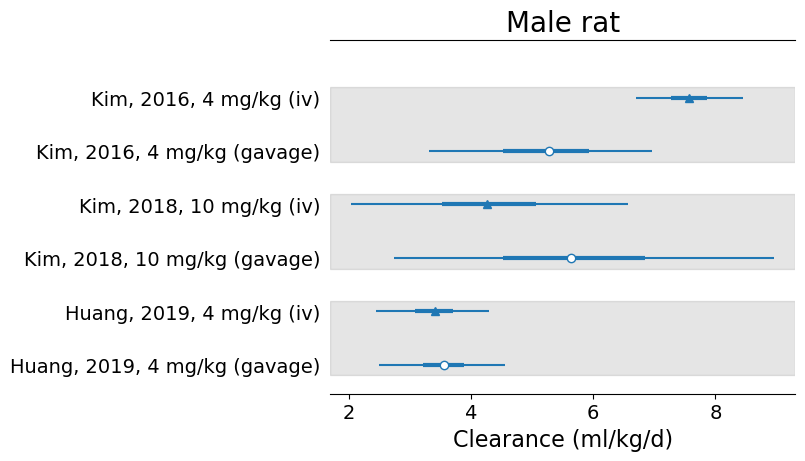

In [10]:
mapper = {'5387170-4.0 mg/kg-gavage': 'Huang, 2019, 4 mg/kg (gavage)',
          '5387170-4.0 mg/kg-iv':'Huang, 2019, 4 mg/kg (iv)',
          '4239569-10.0 mg/kg-gavage': 'Kim, 2018, 10 mg/kg (gavage)',
          '4239569-10.0 mg/kg-iv': 'Kim, 2018, 10 mg/kg (iv)',
          '3749289-4.0 mg/kg-gavage': 'Kim, 2016, 4 mg/kg (gavage)',
          '3749289-4.0 mg/kg-iv':'Kim, 2016, 4 mg/kg (iv)',
    
}
pfas_male_2cmpt.plot_CLC_diff(mapper=mapper, units='ml')
plt.savefig('../posterior_pk/PFHxS_male_rat_CLC_diff.png', dpi=300, bbox_inches='tight')

3749289-4.0 mg/kg-iv 3749289-4.0 mg/kg-gavage
4239569-10.0 mg/kg-iv 4239569-10.0 mg/kg-gavage
5387170-4.0 mg/kg-iv 5387170-4.0 mg/kg-gavage


3749289: 4.0 mg/kg      0.9952857142857143
4239569: 10.0 mg/kg    0.23739285714285716
5387170: 4.0 mg/kg     0.40117857142857144
dtype: object

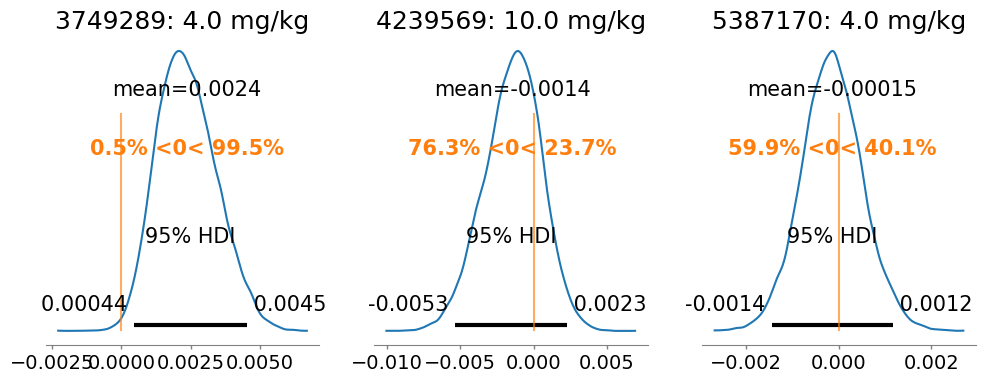

In [11]:
pfas_male_2cmpt.plot_ref()

Kim, 2016, 4 mg/kg      14.06
Kim, 2018, 10 mg/kg     33.48
Huang, 2019, 4 mg/kg    71.66
dtype: float64

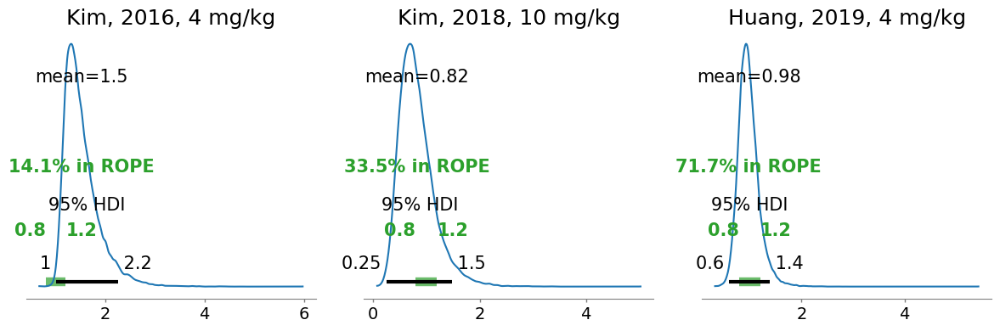

In [12]:
mapper = {
    '3749289: 4.0 mg/kg': 'Kim, 2016, 4 mg/kg',
    '4239569: 10.0 mg/kg': 'Kim, 2018, 10 mg/kg',
    '5387170: 4.0 mg/kg': 'Huang, 2019, 4 mg/kg',
    
}
pfas_male_2cmpt.plot_ROPE(mapper=mapper)

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


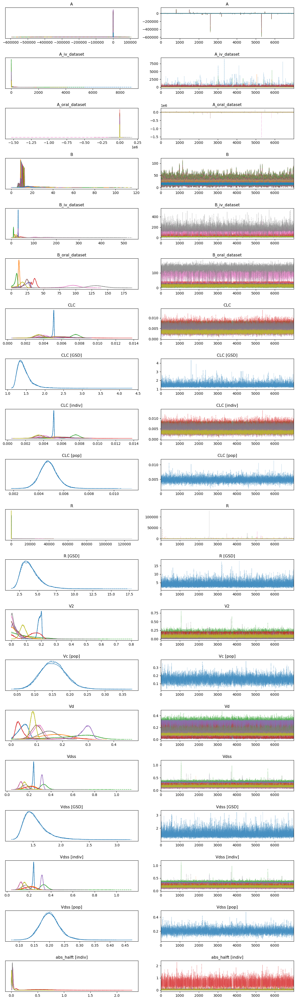

In [13]:
with pfas_male_2cmpt.model: # orig prior
    az.plot_trace(pfas_male_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


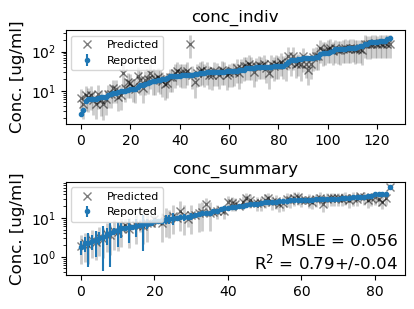

In [14]:
pfas_male_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:1024: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal poster

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-1547.661752,85.680587,0.00000,0.789526,84.291260,0.000000,True,log
1_compartment,1,-1626.826072,62.834880,79.16432,0.210474,87.417471,37.475519,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

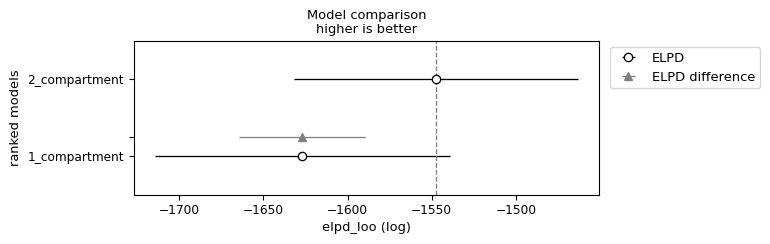

In [15]:
pfas_male_compare = az.compare({"1_compartment": pfas_male_1cmpt._trace, "2_compartment": pfas_male_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_male_compare)
az.plot_compare(pfas_male_compare, insample_dev=False)

#### Define winning model

In [16]:
pfas_male = pfas_male_2cmpt
print(pfas_male.N_divergences)
print(f'Pass all metrics = {pfas_male.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


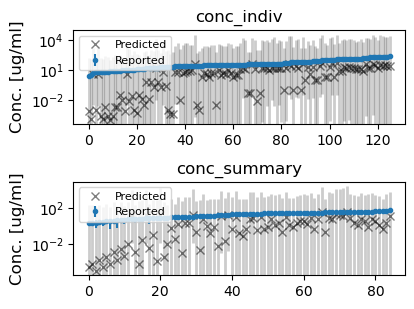

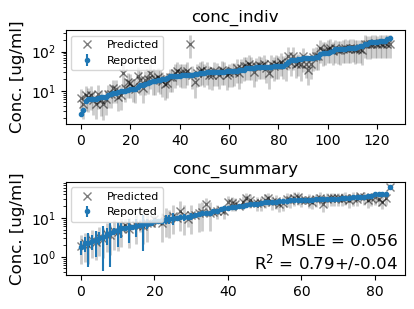

In [17]:
pfas_male.plot_data_ppc(group='prior', savefig=True)
pfas_male.plot_data_ppc(group='posterior', savefig=True)

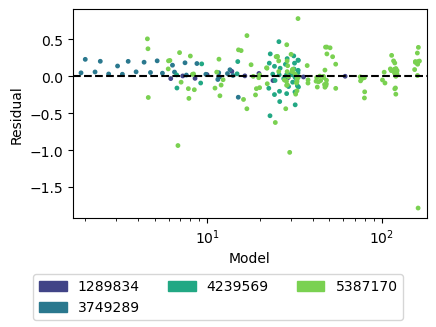

In [18]:
pfas_male.plot_residuals() 

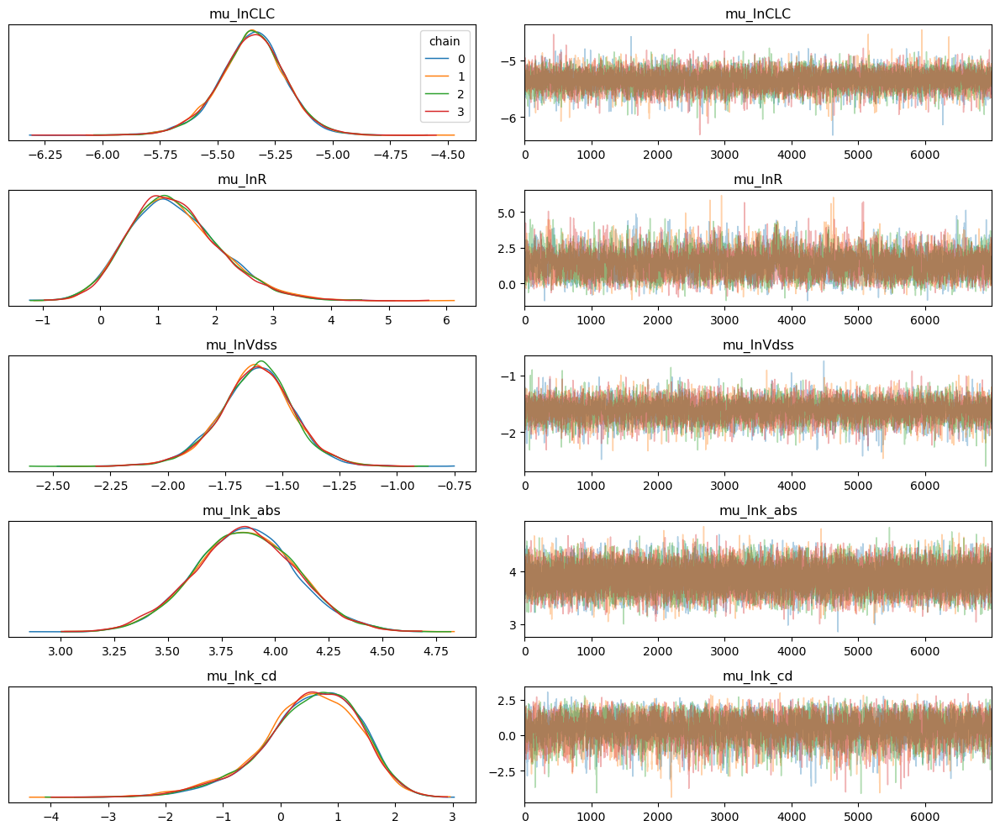

In [19]:
trace_model = pfas_male
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFHxS/PFHxS_Male_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


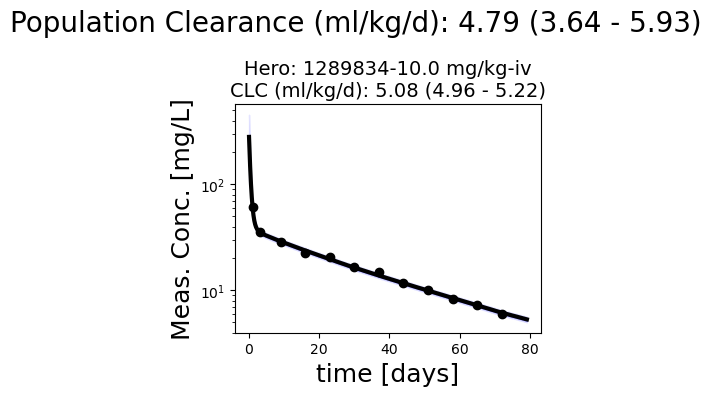

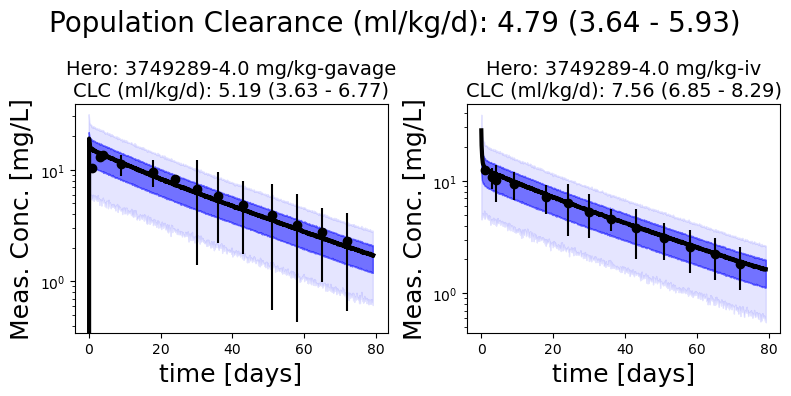

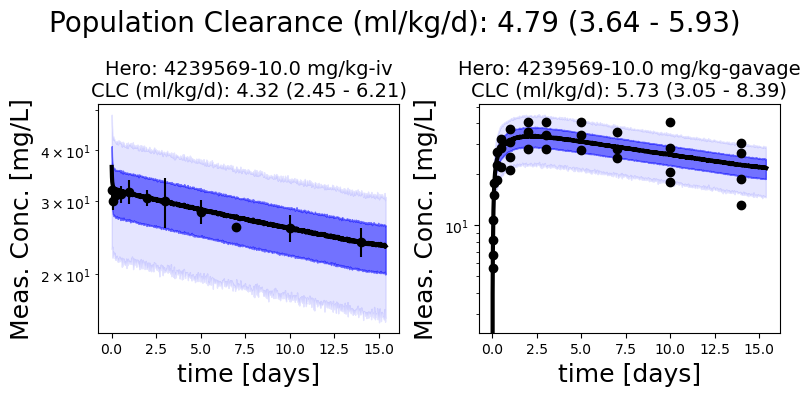

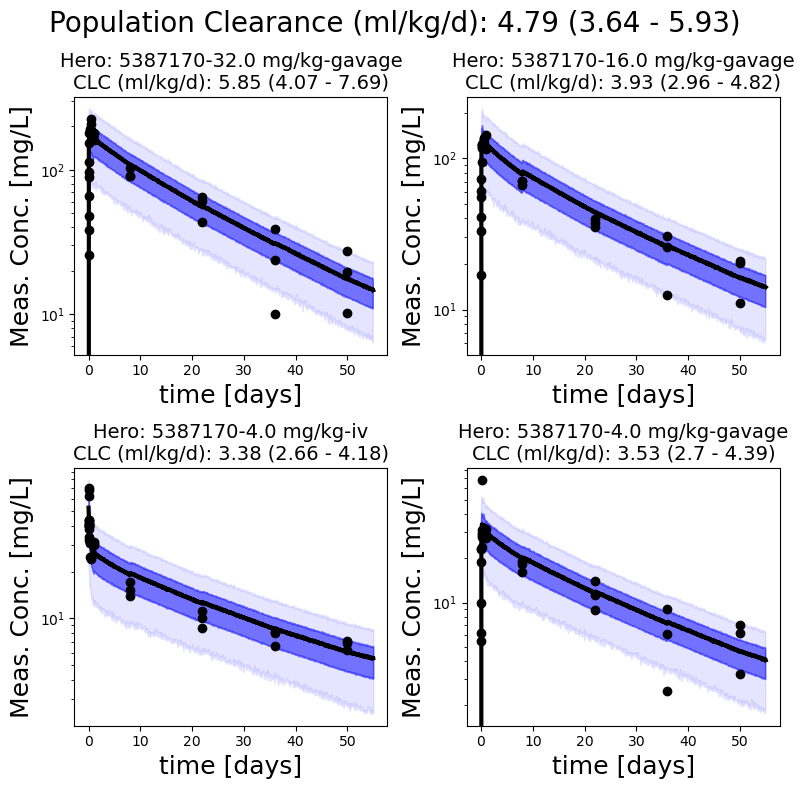

In [20]:
pfas_male.plot_all_studies()

### PK stats

In [21]:
male_rat_draws = pfas_male.generate_samples(var_names = ['CLC [pop]', 'Vc [pop]', 'mu_k_dc', 'mu_k_cd', 'mu_k_abs', 'mu_fa'])
male_rat_draws.to_csv('../posterior_pk/PFHxS_Male_Rat_20240812.csv')

In [22]:
pfas_male.get_pk_stats(level='indiv', vol_units='ml', pk_stat='halft ')

,mean,sd,hdi_5%,hdi_95%
halft [indiv][1289834-10.0 mg/kg-iv],32.31554,0.99635,31.16748,33.59464
halft [indiv][3749289-4.0 mg/kg-gavage],29.01005,2.81870,24.81099,33.15476
halft [indiv][3749289-4.0 mg/kg-iv],31.04620,4.03170,25.87152,35.81853
halft [indiv][4239569-10.0 mg/kg-gavage],26.82478,11.17180,13.67981,44.10542
halft [indiv][4239569-10.0 mg/kg-iv],55.92635,20.20822,29.34100,79.97994
halft [indiv][5387170-4.0 mg/kg-gavage],26.42498,8.01186,18.57501,34.06137
halft [indiv][5387170-16.0 mg/kg-gavage],23.78811,7.06506,17.32348,29.57380
halft [indiv][5387170-32.0 mg/kg-gavage],19.87584,4.71510,15.81299,23.00108
halft [indiv][5387170-4.0 mg/kg-iv],35.10431,9.69188,22.92547,46.94782


In [23]:
pfas_male.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],4.79000,0.71000,3.64000,5.93000
Vc [pop],0.15295,0.03583,0.09487,0.21067
Vdss [pop],201.55000,33.11000,146.92000,252.57000
abs_halft [pop],0.01497,0.00358,0.00921,0.02055
fa [pop],0.86901,0.10203,0.73506,0.99945
halft [pop],29.71266,6.33152,19.97128,39.51558
halft_alpha [pop],0.15047,0.31673,0.00258,0.29674
halft_beta [pop],29.78721,6.37232,19.96072,39.57637


## Female

In [24]:
%%time
pfas_female_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='rat')
pfas_female_data.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
dropping duplicated column
Hero ID used:  [1289834 3749289 4239569 5387170]
CPU times: user 686 ms, sys: 3.89 ms, total: 690 ms
Wall time: 691 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,12,-1,4,-1.0,NaN,0.203771,NaN,rat,sprague-dawley,10.0,mg/kg,1.0,day,73.968668,9.503916,1,ug/ml,iv,serum,Female,DTXSID7040150,Figure 5,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,3,0,0,0,1.000000,10.0,64.000000,0.203771,73.968668,19.007833,0.0,-1,0,0,1,0.252874,4.271669,0.256971,False,2.037714,1289834-10.0 mg/kg-iv
1,1289834,12,-1,4,-1.0,NaN,0.203771,NaN,rat,sprague-dawley,10.0,mg/kg,3.0,day,24.804178,4.569191,1,ug/ml,iv,serum,Female,DTXSID7040150,Figure 5,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,3,0,0,0,3.000000,10.0,66.000000,0.206914,24.804178,9.138381,0.0,-1,0,0,1,0.356762,3.147372,0.368421,False,2.037714,1289834-10.0 mg/kg-iv
2,1289834,12,-1,4,-1.0,NaN,0.203771,NaN,rat,sprague-dawley,10.0,mg/kg,9.0,day,1.592689,0.180000,1,ug/ml,iv,serum,Female,DTXSID7040150,Figure 5,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,3,0,0,0,9.000000,10.0,72.000000,0.216400,1.592689,0.360000,0.0,-1,0,0,1,0.223223,0.440510,0.226033,False,2.037714,1289834-10.0 mg/kg-iv
3,3749289,18,-1,5,-1.0,NaN,0.213233,NaN,rat,sprague-dawley,4.0,mg/kg,0.5,hour,14148.516330,0.000000,1,ng/ml,iv,plasma,Female,DTXSID7040150,Figure 4C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,1,0,1,0.020833,4.0,70.020833,0.213233,14.148516,0.000000,0.0,-1,0,0,1,0.000000,2.649610,0.000000,False,0.852933,3749289-4.0 mg/kg-iv
4,3749289,18,-1,5,-1.0,NaN,0.213233,NaN,rat,sprague-dawley,4.0,mg/kg,1.0,hour,11985.964460,0.000000,1,ng/ml,iv,plasma,Female,DTXSID7040150,Figure 4C,10.0,weeks,NaN,Not Reported,5,Kim,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,12,1,0,1,0.041667,4.0,70.041667,0.213267,11.985964,0.000000,0.0,-1,0,0,1,0.000000,2.483736,0.000000,False,0.852933,3749289-4.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [25]:
pfas_female_1cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_rat_1cmpt
hierarchical model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


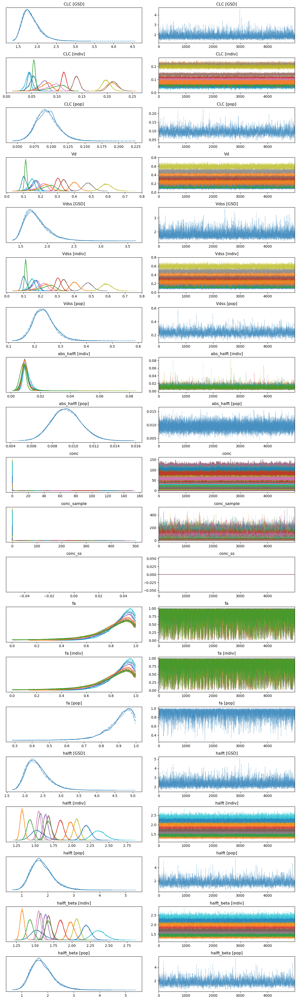

In [26]:
with pfas_female_1cmpt.model:
    az.plot_trace(pfas_female_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


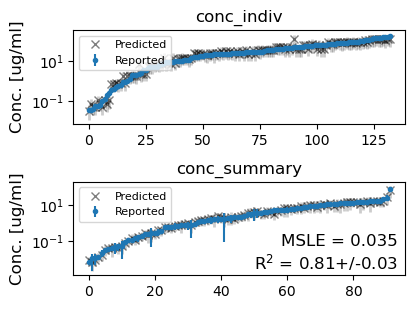

In [27]:
pfas_female_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [28]:
pfas_female_2cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro', random_seed=98765,
                   load_trace=load_trace, tune=15000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)


PFHxS_Female_rat_2cmpt
hierarchical model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


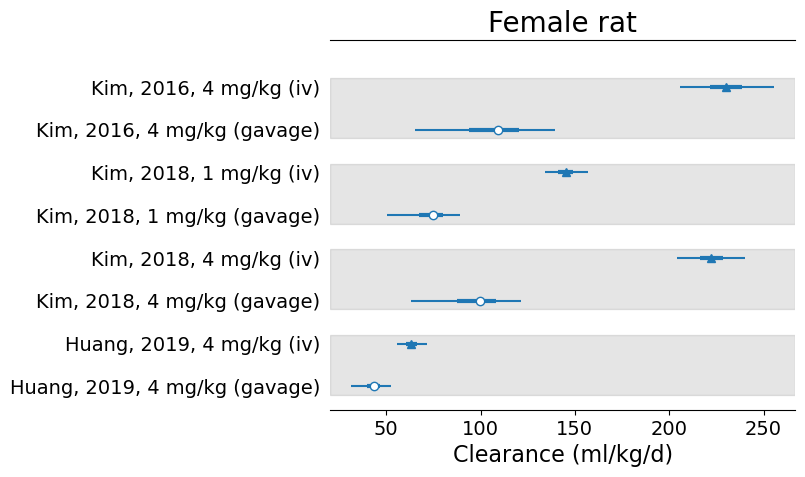

In [29]:
mapper = {'5387170-4.0 mg/kg-gavage': 'Huang, 2019, 4 mg/kg (gavage)',
          '5387170-4.0 mg/kg-iv':'Huang, 2019, 4 mg/kg (iv)',
          '4239569-4.0 mg/kg-gavage': 'Kim, 2018, 4 mg/kg (gavage)',
          '4239569-4.0 mg/kg-iv': 'Kim, 2018, 4 mg/kg (iv)',
          '4239569-1.0 mg/kg-gavage': 'Kim, 2018, 1 mg/kg (gavage)',
          '4239569-1.0 mg/kg-iv': 'Kim, 2018, 1 mg/kg (iv)',
          '3749289-4.0 mg/kg-gavage': 'Kim, 2016, 4 mg/kg (gavage)',
          '3749289-4.0 mg/kg-iv':'Kim, 2016, 4 mg/kg (iv)',
    
}
pfas_female_2cmpt.plot_CLC_diff(mapper=mapper, units='ml')
plt.savefig('../posterior_pk/PFHxS_female_rat_CLC_diff.png', dpi=300, bbox_inches='tight')

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


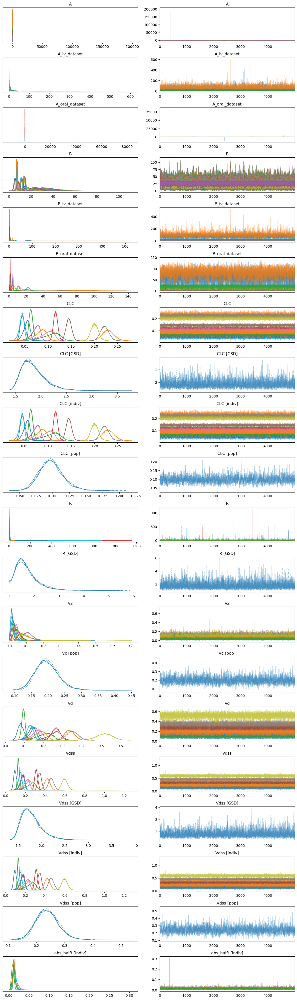

In [30]:
with pfas_female_2cmpt.model:
    az.plot_trace(pfas_female_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


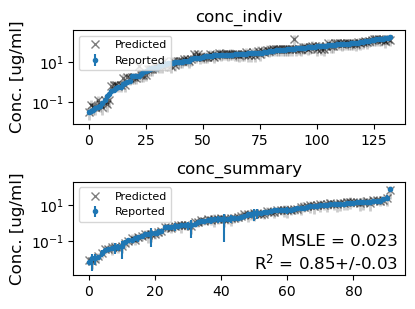

In [31]:
pfas_female_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-652.765111,62.543992,0.00000,0.985317,95.039232,0.000000,True,log
1_compartment,1,-700.058081,56.840848,47.29297,0.014683,97.509107,10.690459,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

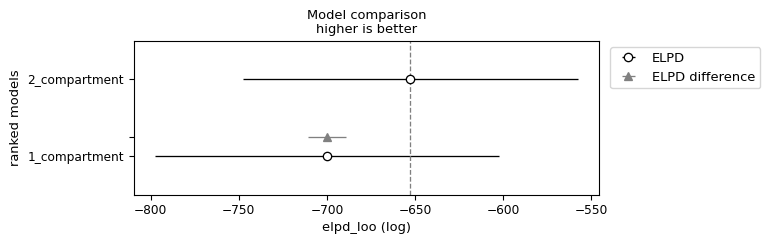

In [32]:
pfas_female_compare = az.compare({"1_compartment": pfas_female_1cmpt._trace, "2_compartment": pfas_female_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_female_compare)
az.plot_compare(pfas_female_compare, insample_dev=False)

#### Define winning model

In [33]:
pfas_female = pfas_female_2cmpt
print(pfas_female.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


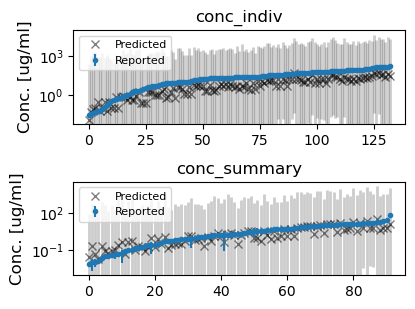

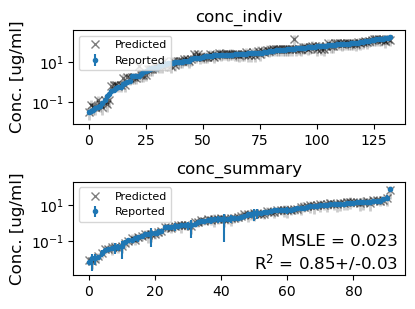

In [34]:
pfas_female.plot_data_ppc(group='prior', savefig=True)
pfas_female.plot_data_ppc(group='posterior', savefig=True)

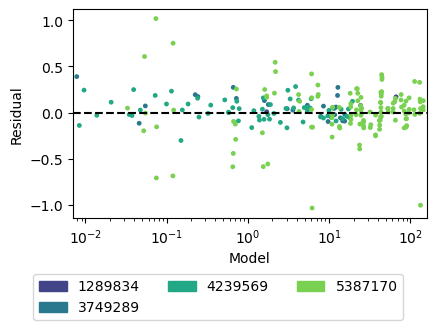

In [35]:
pfas_female.plot_residuals() 

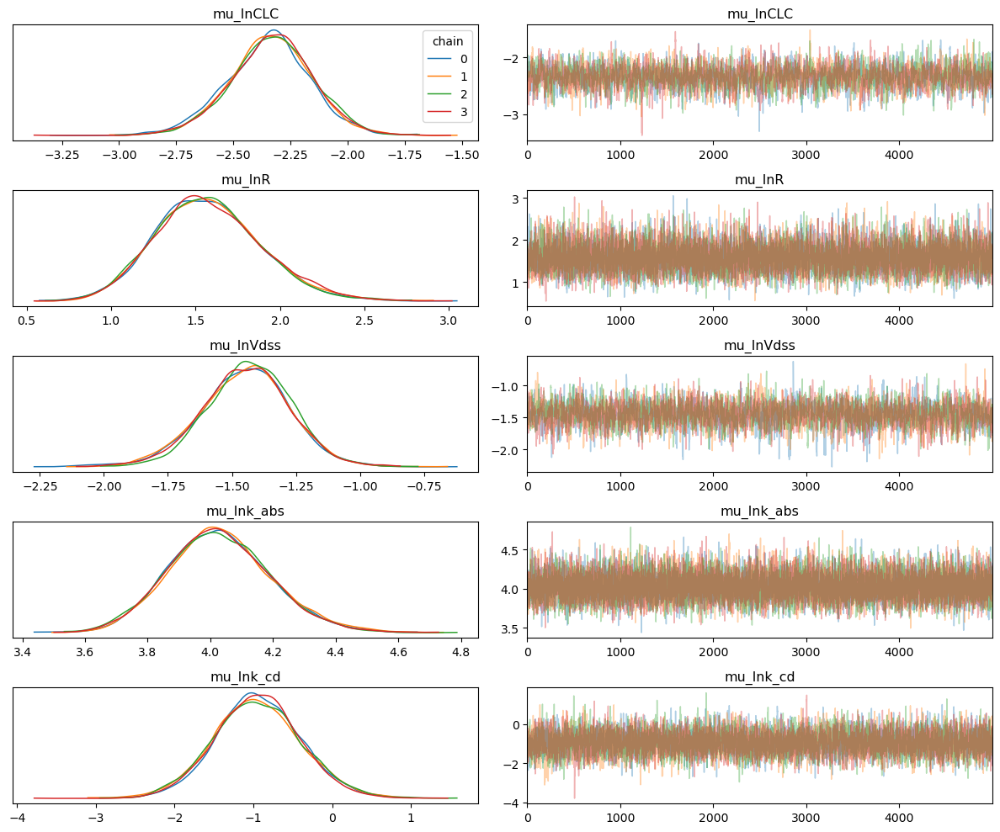

In [36]:
trace_model = pfas_female
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFHxS/PFHxS_Female_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


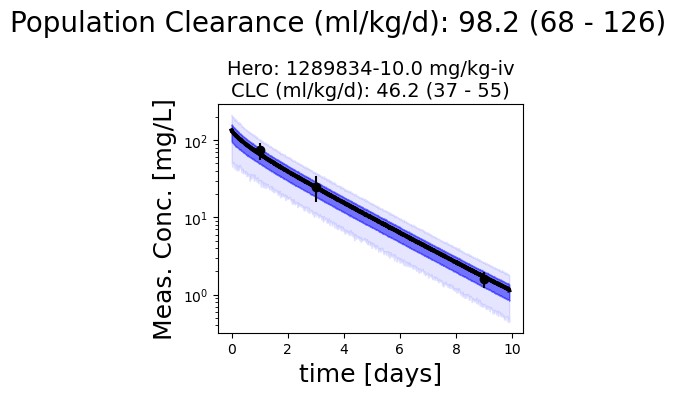

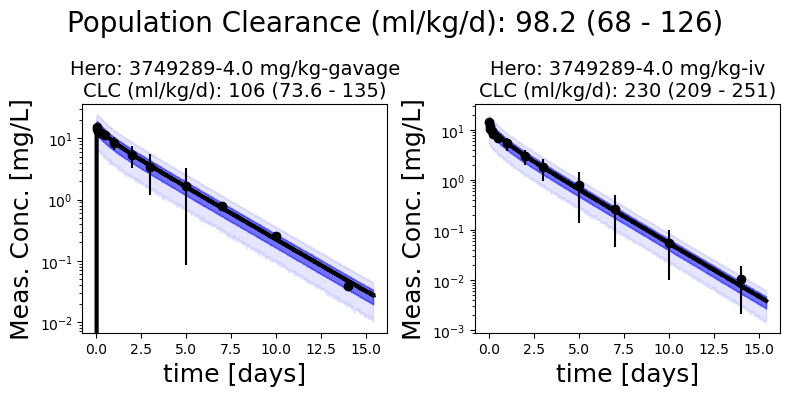

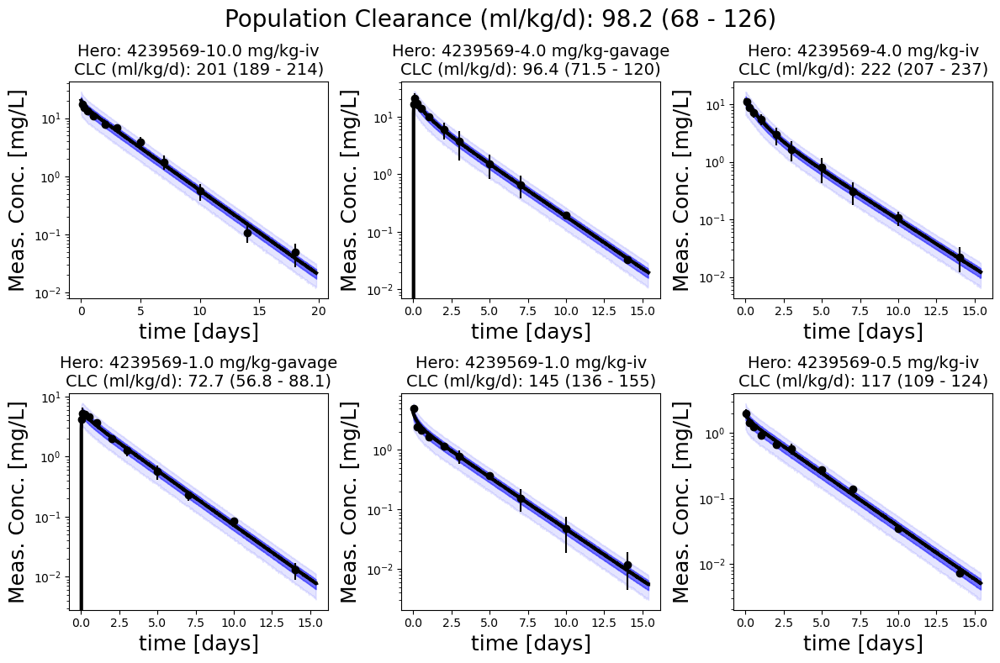

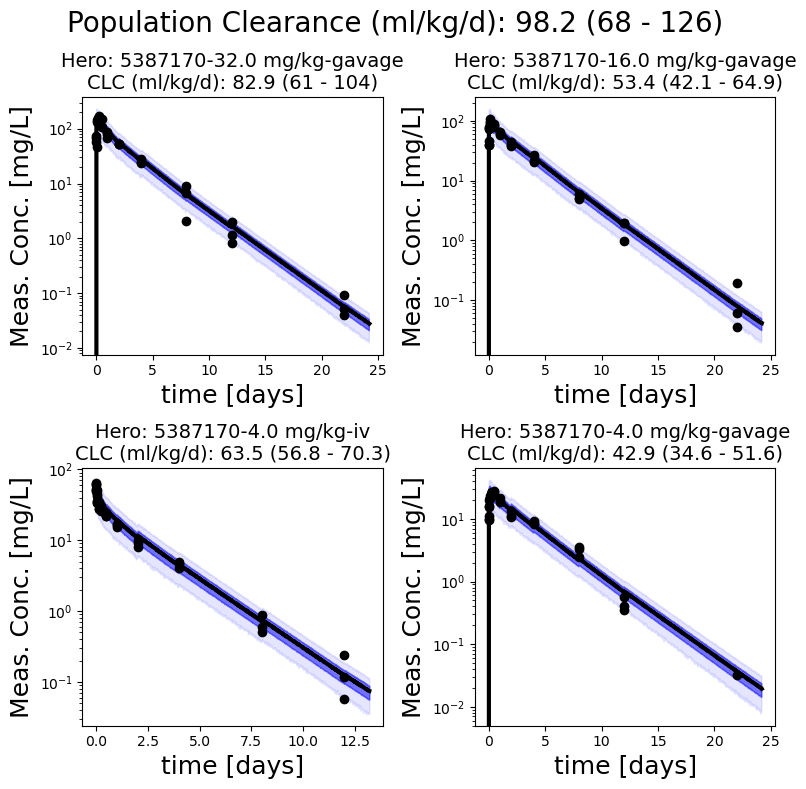

In [37]:
pfas_female.plot_all_studies()

### PK stats

In [38]:
female_rat_draws = pfas_female.generate_samples(var_names = ['CLC [pop]', 'Vc [pop]', 'mu_k_dc', 'mu_k_cd', 'mu_k_abs', 'mu_fa'])
female_rat_draws.to_csv('../posterior_pk/PFHxS_Female_Rat_20240812.csv')

In [39]:
pfas_female.get_pk_stats(level='indiv', vol_units='ml', pk_stat='halft ')

,mean,sd,hdi_5%,hdi_95%
halft [indiv][1289834-10.0 mg/kg-iv],1.50229,0.23287,1.28340,1.69481
halft [indiv][3749289-4.0 mg/kg-iv],1.27253,0.04563,1.19943,1.34732
halft [indiv][3749289-4.0 mg/kg-gavage],1.66806,0.05347,1.58257,1.75938
halft [indiv][4239569-0.5 mg/kg-iv],1.84329,0.04193,1.77478,1.91298
halft [indiv][4239569-1.0 mg/kg-gavage],1.61793,0.03849,1.55586,1.68215
halft [indiv][4239569-1.0 mg/kg-iv],1.64841,0.04085,1.57959,1.71292
halft [indiv][4239569-4.0 mg/kg-gavage],1.48002,0.04151,1.41184,1.54863
halft [indiv][4239569-4.0 mg/kg-iv],1.43947,0.04563,1.36308,1.51388
halft [indiv][4239569-10.0 mg/kg-iv],2.05943,0.04857,1.99842,2.12565
halft [indiv][5387170-4.0 mg/kg-gavage],2.35009,0.09140,2.20371,2.49102


In [40]:
pfas_female.get_pk_stats(vol_units = 'ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],98.21000,17.90000,68.03000,125.70000
Vc [pop],0.19751,0.03567,0.14071,0.25470
Vdss [pop],239.64000,41.56000,172.73000,305.16000
abs_halft [pop],0.01249,0.00201,0.00913,0.01576
fa [pop],0.89551,0.08548,0.78528,0.99931
halft [pop],1.74444,0.43071,1.05538,2.39320
halft_alpha [pop],0.31260,0.12741,0.10401,0.49638
halft_beta [pop],1.83533,0.42751,1.12938,2.45820


# Mouse

## Male

In [41]:
%%time
pfas_male_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='mouse')
pfas_male_data_mouse.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
dropping duplicated column
Hero ID used:  [1289834]
CPU times: user 75.3 ms, sys: 2.03 ms, total: 77.3 ms
Wall time: 76.7 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,2.0,day,7.720572,0.209021,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,2.0,1.0,0.031,7.720572,0.418042,0.0,-1,0,1,0,0.054107,2.042425,0.054146,False,0.031,1289834-1.0 mg/kg-gavage
1,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,8.0,day,8.303630,0.352035,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,8.0,1.0,0.031,8.303630,0.704070,0.0,-1,0,1,0,0.084639,2.113111,0.084791,False,0.031,1289834-1.0 mg/kg-gavage
2,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,15.0,day,6.675468,0.000000,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,15.0,1.0,0.031,6.675468,0.000000,0.0,-1,0,1,0,0.000000,1.898439,0.000000,False,0.031,1289834-1.0 mg/kg-gavage
3,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,22.0,day,4.420242,0.242024,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,22.0,1.0,0.031,4.420242,0.484048,0.0,-1,0,1,0,0.109181,1.480234,0.109507,False,0.031,1289834-1.0 mg/kg-gavage
4,1289834,13,-1,4,-1.0,NaN,0.031,NaN,mouse,CD-1,1.0,mg/kg,36.0,day,3.133113,0.330033,1,ug/ml,gavage,serum,Male,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,36.0,1.0,0.031,3.133113,0.660066,0.0,-1,0,1,0,0.208391,1.120314,0.210674,False,0.031,1289834-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [42]:
pfas_male_1cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_mouse_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


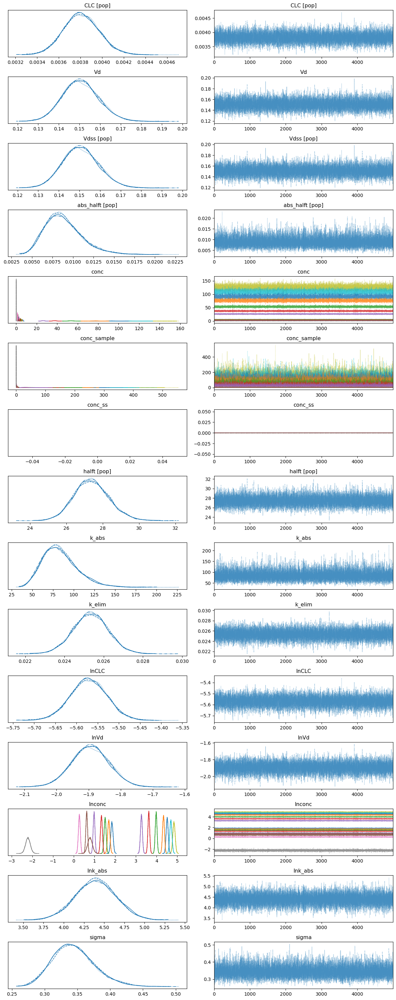

In [43]:
with pfas_male_1cmpt_mouse.model:
    az.plot_trace(pfas_male_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


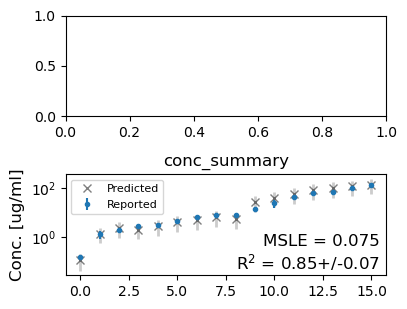

In [44]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [45]:
pfas_male_2cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_mouse_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = False
Assign pareto...


/data/tzurlind/Desktop/PKWG/manuscript_code/animal_pfas_manuscript/pfas_notebooks/../PyPKMC.py:1025: UserWarning: There were 11 divergences after tuning. Increase `target_accept` or reparameterize.
  warnings.warn(msg)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


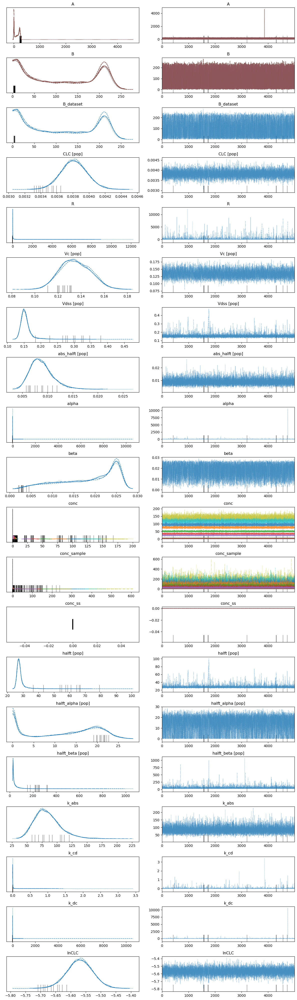

In [46]:
with pfas_male_2cmpt_mouse.model:
    az.plot_trace(pfas_male_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


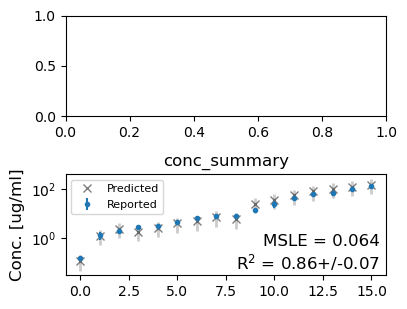

In [47]:
pfas_male_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
1_compartment,0,-171.794127,8.597280,0.000000,0.501479,27.246035,0.000000,True,log
2_compartment,1,-173.182968,15.052077,1.388841,0.498521,26.428039,3.858835,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

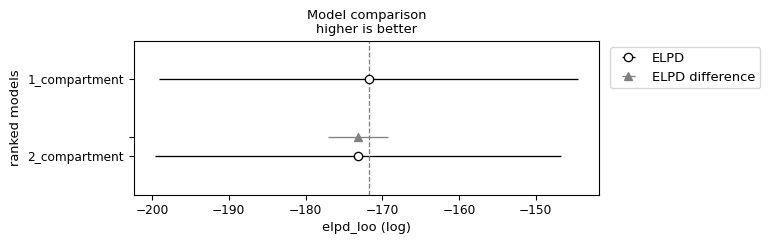

In [48]:
pfas_male_mouse_compare = az.compare({"1_compartment": pfas_male_1cmpt_mouse._trace, "2_compartment": pfas_male_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_male_mouse_compare)
az.plot_compare(pfas_male_mouse_compare, insample_dev=False)

#### Define winning model

In [49]:
pfas_male_mouse = pfas_male_1cmpt_mouse
print(pfas_male_mouse.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


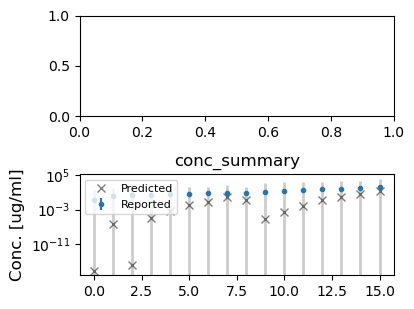

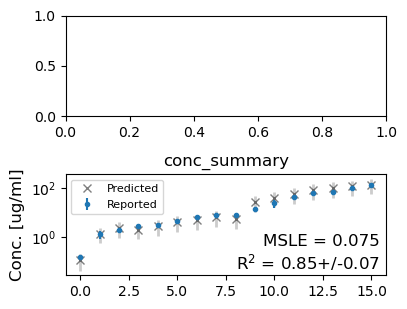

In [50]:
pfas_male_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_male_mouse.plot_data_ppc(group='posterior', savefig=True)

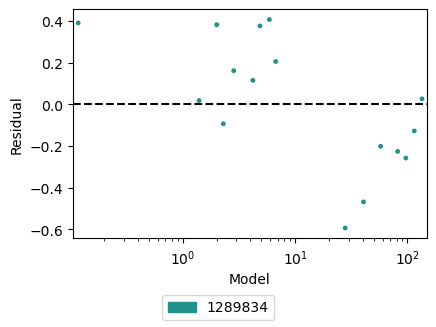

In [51]:
pfas_male_mouse.plot_residuals() 

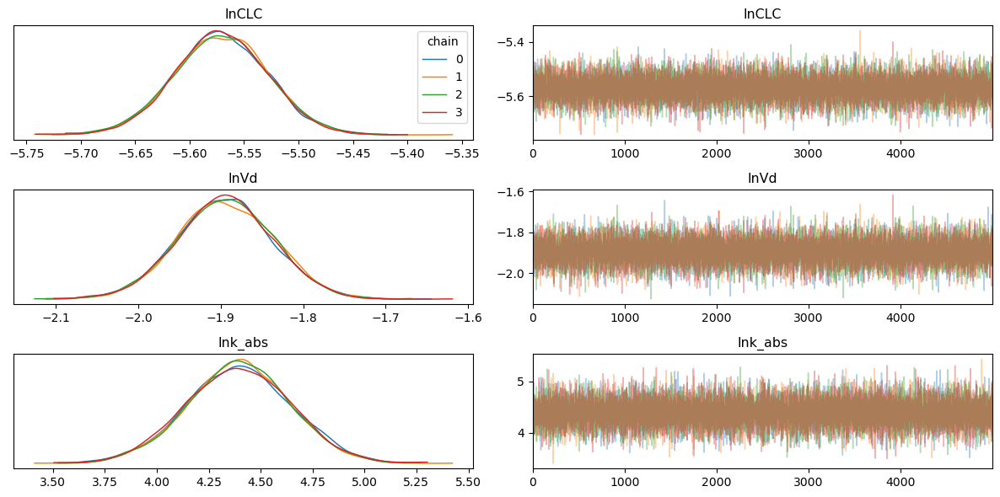

In [52]:
trace_model = pfas_male_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFHxS/PFHxS_Male_mouse_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


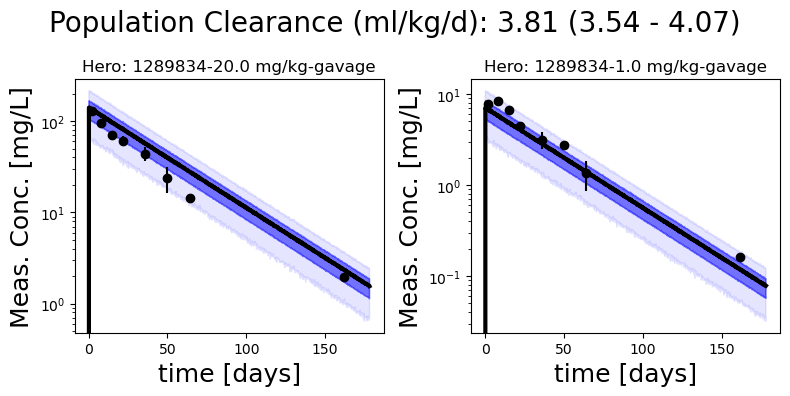

In [53]:
pfas_male_mouse.plot_all_studies()

### PK stats

In [54]:
#male_mouse_draws = pfas_male_mouse.generate_samples(var_names = ['CLC [pop]', 'Vdss [pop]', 'k_abs'])
#male_mouse_draws.to_csv('../posterior_pk/PFHxS_Male_Mouse_20240110.csv')

In [55]:
pfas_male_mouse.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],3.81000,0.16000,3.54000,4.08000
Vdss [pop],150.58000,8.75000,136.09000,164.66000
abs_halft [pop],0.00883,0.00224,0.00532,0.01233
halft [pop],27.39733,0.97178,25.82649,29.01623


## Female

In [56]:
%%time
pfas_female_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='mouse')
pfas_female_data_mouse.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
No BW info for mouse in 1289834, using defaults
dropping duplicated column
Hero ID used:  [1289834]
CPU times: user 72.7 ms, sys: 2.95 ms, total: 75.7 ms
Wall time: 75 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,2.0,day,9.843784,0.715072,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,2.0,1.0,0.029,9.843784,1.430143,0.0,-1,0,1,1,0.144526,2.276396,0.145284,False,0.029,1289834-1.0 mg/kg-gavage
1,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,8.0,day,7.819582,0.319032,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,8.0,1.0,0.029,7.819582,0.638064,0.0,-1,0,1,1,0.081463,2.053313,0.081598,False,0.029,1289834-1.0 mg/kg-gavage
2,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,15.0,day,6.686469,0.000000,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,15.0,1.0,0.029,6.686469,0.000000,0.0,-1,0,1,1,0.000000,1.900086,0.000000,False,0.029,1289834-1.0 mg/kg-gavage
3,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,22.0,day,4.937294,0.264026,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,22.0,1.0,0.029,4.937294,0.528053,0.0,-1,0,1,1,0.106648,1.591130,0.106952,False,0.029,1289834-1.0 mg/kg-gavage
4,1289834,14,-1,4,-1.0,NaN,0.029,NaN,mouse,CD-1,1.0,mg/kg,36.0,day,4.200220,0.198020,1,ug/ml,gavage,serum,Female,DTXSID7040150,Figure 8,9.0,weeks,NaN,Not Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,8,0,0,0,36.0,1.0,0.029,4.200220,0.396040,0.0,-1,0,1,1,0.094082,1.430711,0.094290,False,0.029,1289834-1.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [57]:
pfas_female_1cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_mouse_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


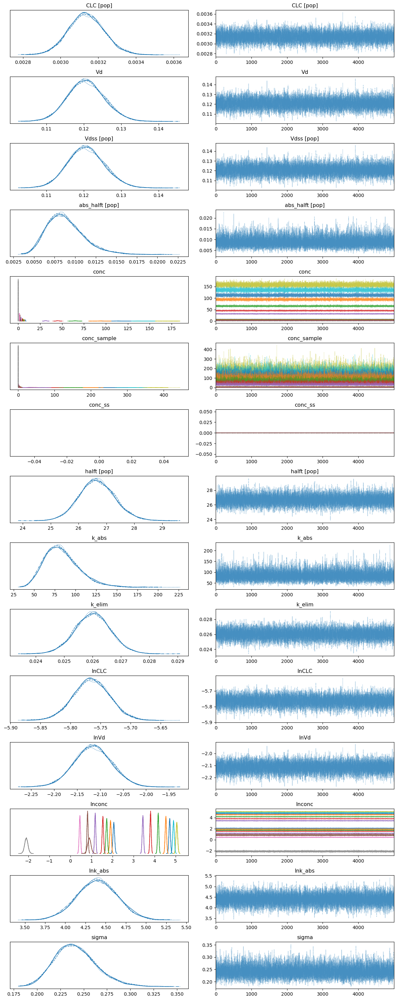

In [58]:
with pfas_female_1cmpt_mouse.model:
    az.plot_trace(pfas_female_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


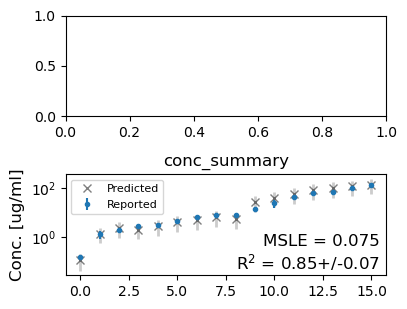

In [59]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [60]:
pfas_female_2cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_mouse_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = False
Assign pareto...


/data/tzurlind/Desktop/PKWG/manuscript_code/animal_pfas_manuscript/pfas_notebooks/../PyPKMC.py:1025: UserWarning: There were 44 divergences after tuning. Increase `target_accept` or reparameterize.
  warnings.warn(msg)


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


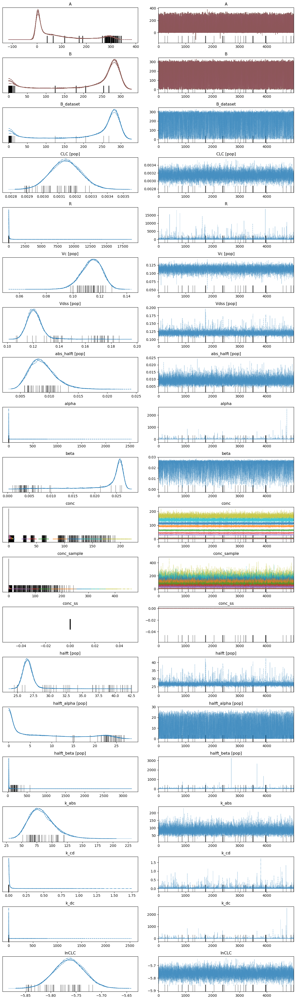

In [61]:
with pfas_female_2cmpt_mouse.model:
    az.plot_trace(pfas_female_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


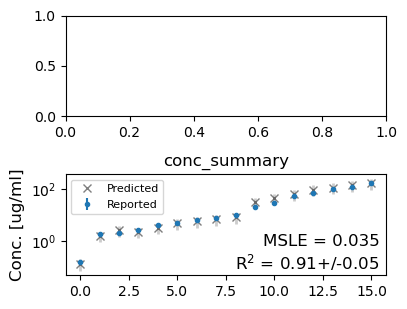

In [62]:
pfas_female_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
1_compartment,0,-161.456120,9.138182,0.000000,0.952667,28.924943,0.000000,True,log
2_compartment,1,-163.329017,14.070382,1.872896,0.047333,27.895909,2.192516,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

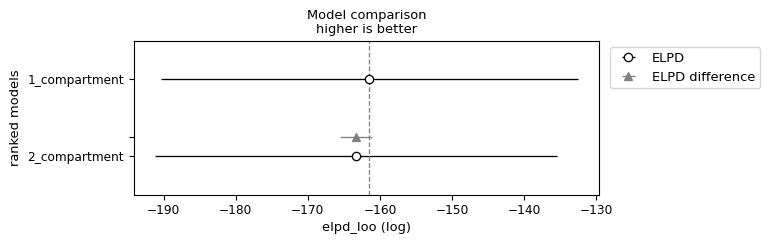

In [63]:
pfas_female_mouse_compare = az.compare({"1_compartment": pfas_female_1cmpt_mouse._trace, "2_compartment": pfas_female_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_female_mouse_compare)
az.plot_compare(pfas_female_mouse_compare, insample_dev=False)

#### Define winning model

In [64]:
pfas_female_mouse = pfas_female_1cmpt_mouse
print(pfas_female_mouse.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


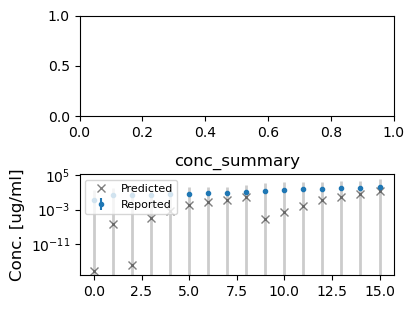

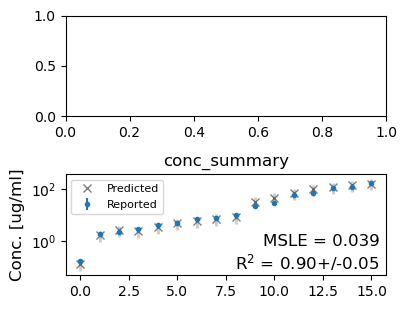

In [65]:
pfas_female_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_female_mouse.plot_data_ppc(group='posterior', savefig=True)

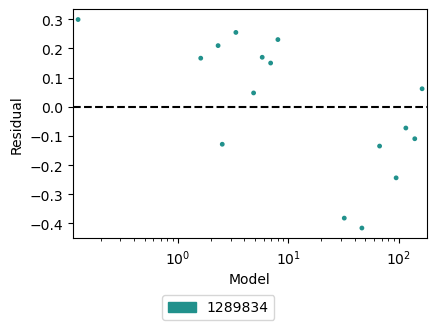

In [66]:
pfas_female_mouse.plot_residuals() 

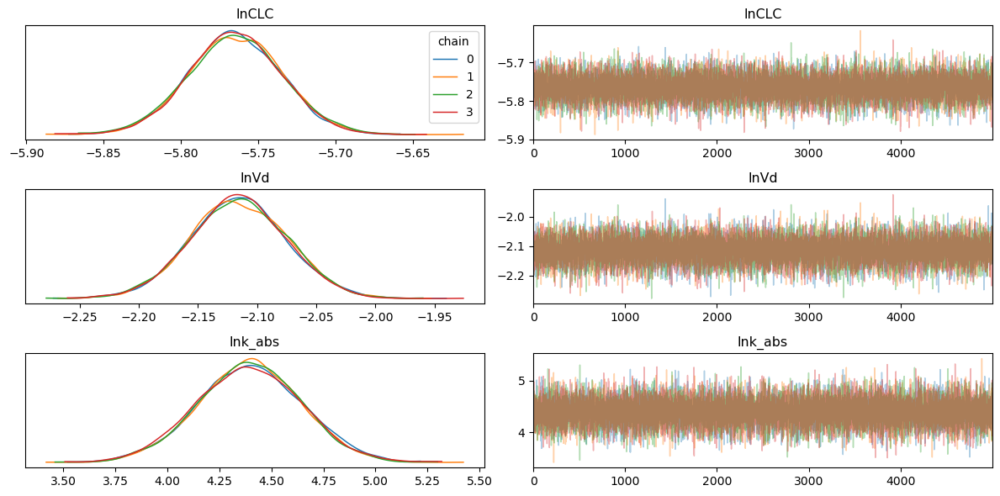

In [67]:
trace_model = pfas_female_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFHxS/PFHxS_Female_mouse_CLC_1cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


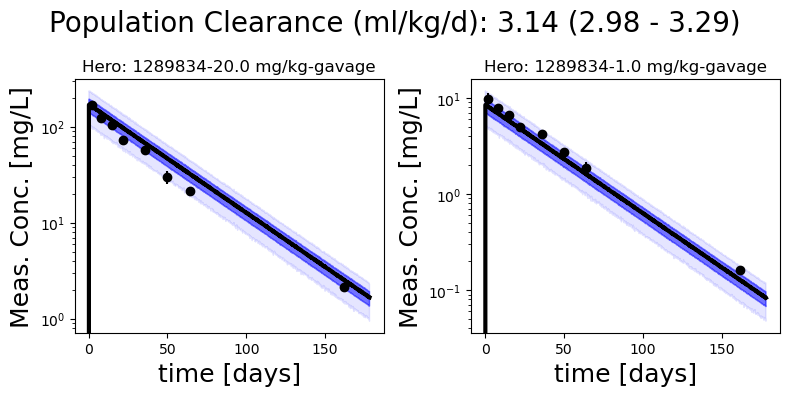

In [68]:
pfas_female_mouse.plot_all_studies()

### PK stats

In [69]:
#female_mouse_draws = pfas_female_mouse.generate_samples(var_names = ['CLC [pop]', 'Vdss [pop]', 'k_abs'])
#female_mouse_draws.to_csv('../posterior_pk/PFHxS_Female_Mouse_20240110.csv')

In [70]:
pfas_female_mouse.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],3.14000,0.10000,2.98000,3.29000
Vdss [pop],120.66000,4.92000,112.77000,128.90000
abs_halft [pop],0.00882,0.00223,0.00531,0.01230
halft [pop],26.66512,0.64078,25.57065,27.68071


# Primate

## Male

In [71]:
%%time
pfas_male_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='primate')
pfas_male_data_primate.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
dropping duplicated column
Hero ID used:  [1289834]
CPU times: user 80.2 ms, sys: 975 μs, total: 81.2 ms
Wall time: 80.5 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,15,1,1,6.009063,kg,6.009063,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,212.400044,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,6.009063,212.400044,0.0,0.0,-1,0,0,0,0.0,5.358471,0.0,True,60.090634,1289834-10.0 mg/kg-iv
1,1289834,15,2,1,6.202417,kg,6.202417,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,157.016736,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,6.202417,157.016736,0.0,0.0,-1,0,0,0,0.0,5.056352,0.0,True,62.024169,1289834-10.0 mg/kg-iv
2,1289834,15,3,1,5.404834,kg,5.404834,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,175.252853,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,5.404834,175.252853,0.0,0.0,-1,0,0,0,0.0,5.166230,0.0,True,54.048338,1289834-10.0 mg/kg-iv
3,1289834,15,1,1,6.009063,kg,6.009063,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,126.236448,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.083333,10.0,6.009063,126.236448,0.0,0.0,-1,0,0,0,0.0,4.838157,0.0,True,60.090634,1289834-10.0 mg/kg-iv
4,1289834,15,2,1,6.202417,kg,6.202417,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,139.723762,0.0,0,ug/ml,iv,serum,Male,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.083333,10.0,6.202417,139.723762,0.0,0.0,-1,0,0,0,0.0,4.939667,0.0,True,62.024169,1289834-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [72]:
pfas_male_1cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_primate_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


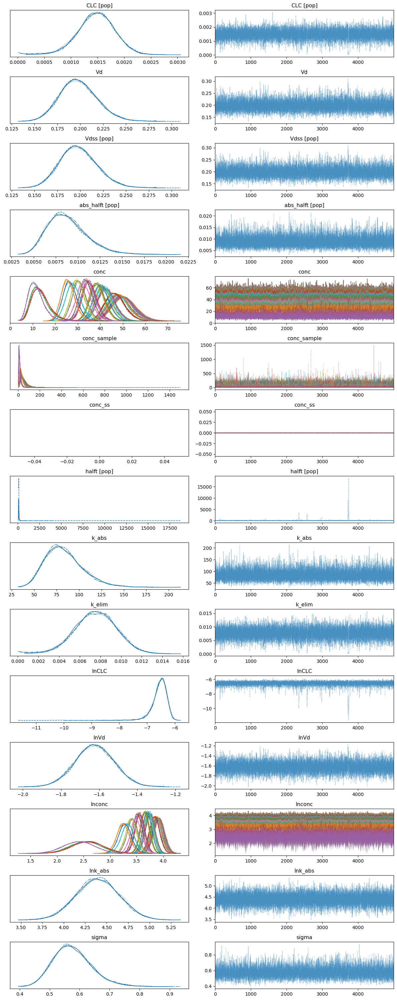

In [73]:
with pfas_male_1cmpt_primate.model:
    az.plot_trace(pfas_male_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


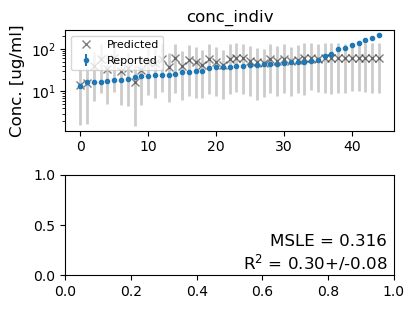

In [74]:
pfas_male_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [75]:
pfas_male_2cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Male_primate_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


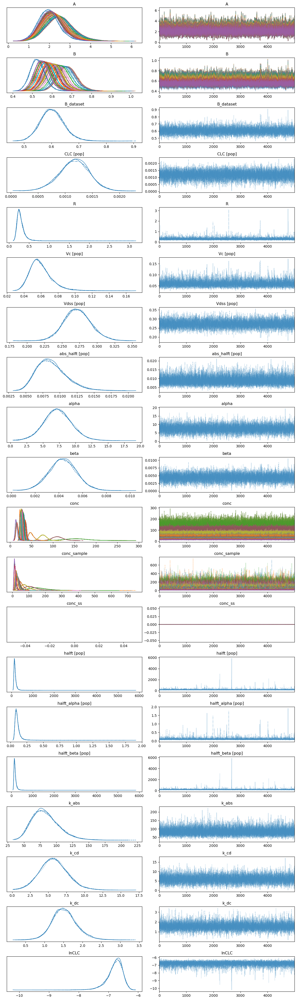

In [76]:
with pfas_male_2cmpt_primate.model:
    az.plot_trace(pfas_male_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


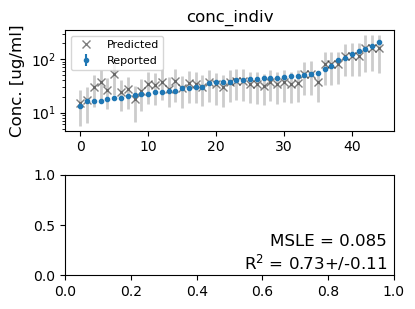

In [77]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

conc_indiv
conc_summary


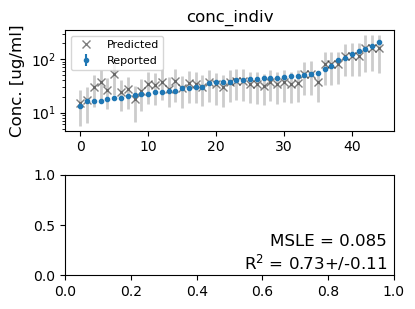

In [78]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-180.540764,5.004514,0.000000,0.961427,7.038545,0.00000,False,log
1_compartment,1,-205.870799,2.805820,25.330035,0.038573,8.386939,6.71093,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

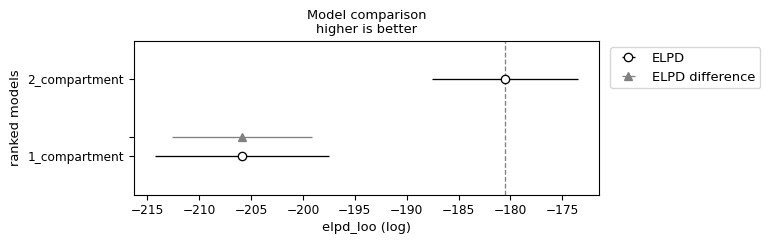

In [79]:
pfas_male_primate_compare = az.compare({"1_compartment": pfas_male_1cmpt_primate._trace, "2_compartment": pfas_male_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_male_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [80]:
pfas_male_primate = pfas_male_2cmpt_primate
print(pfas_male_primate.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


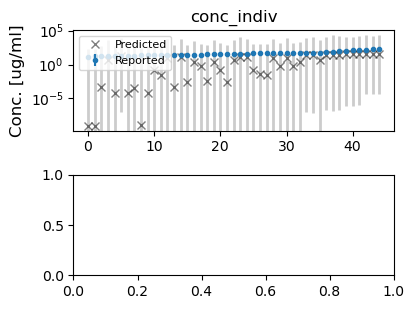

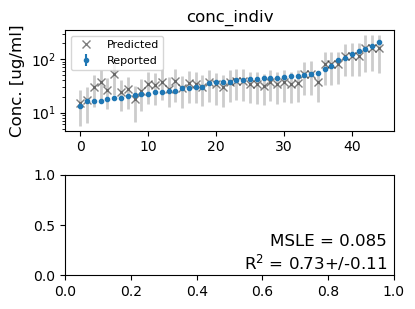

In [81]:
pfas_male_primate.plot_data_ppc(group='prior', savefig=True)
pfas_male_primate.plot_data_ppc(group='posterior', savefig=True)

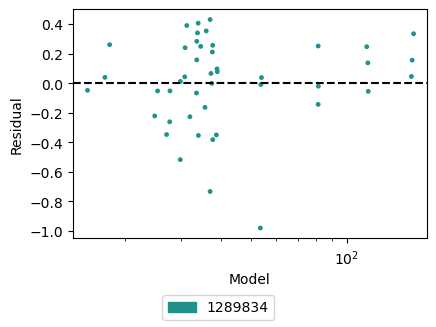

In [82]:
pfas_male_primate.plot_residuals() 

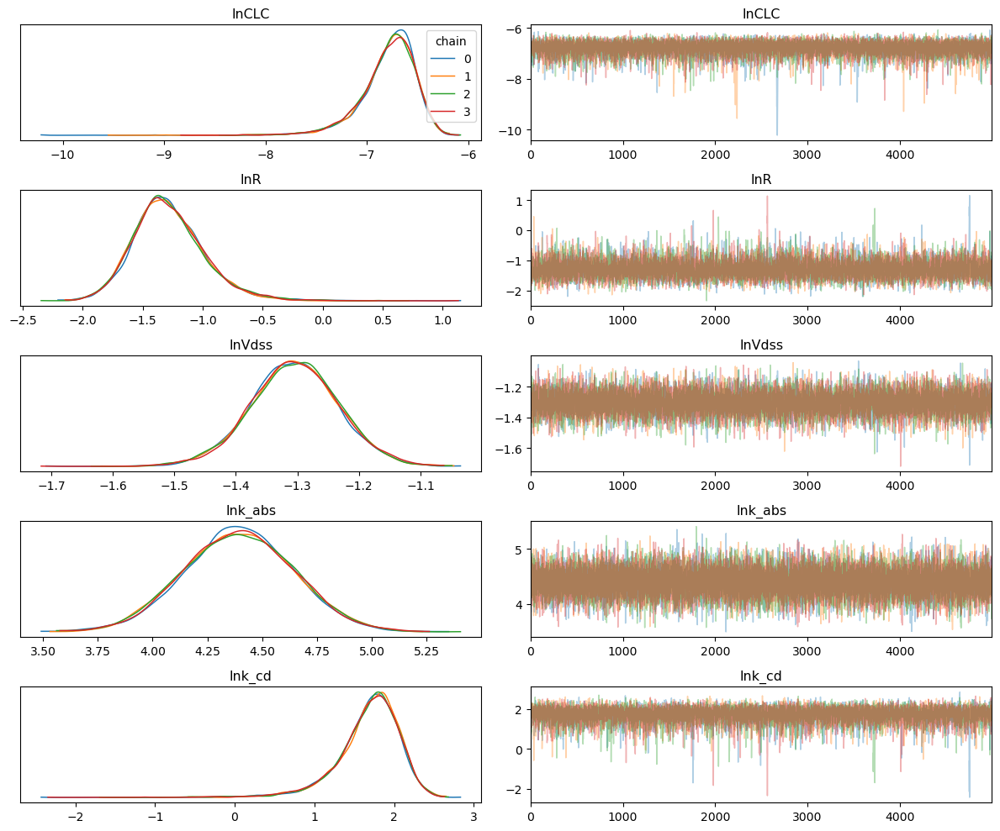

In [83]:
trace_model = pfas_male_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFHxS/PFHxS_Male_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


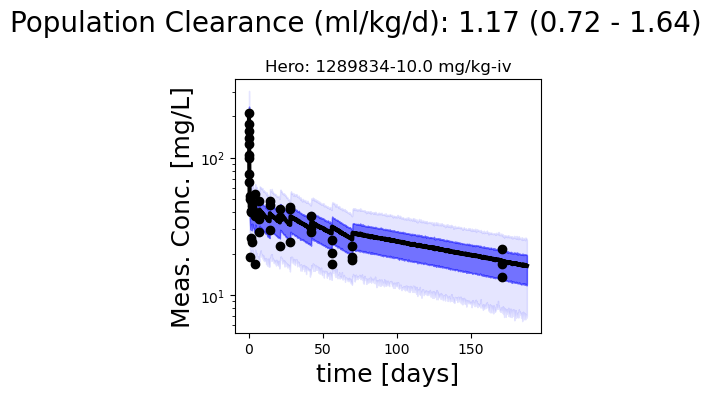

In [84]:
pfas_male_primate.plot_all_studies()

### PK stats

In [85]:
pfas_male_primate.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],1.17000,0.28000,0.72000,1.64000
Vc [pop],0.05987,0.01362,0.03982,0.08063
Vdss [pop],272.01000,19.47000,239.31000,303.19000
abs_halft [pop],0.00883,0.00223,0.00537,0.01236
halft [pop],177.64128,104.24792,95.53627,250.63121
halft_alpha [pop],0.10740,0.06051,0.05323,0.15401
halft_beta [pop],178.01308,104.26789,95.92423,251.12281


## Female

In [86]:
%%time
pfas_female_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='primate')
pfas_female_data_primate.head()

Hero ID available:  [1289834 3749289 4239569 5387170]
dropping duplicated column
Hero ID used:  [1289834]
CPU times: user 80.1 ms, sys: 29 μs, total: 80.1 ms
Wall time: 79.4 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,1289834,16,4,1,3.604230,kg,3.604230,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,186.591427,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,3.604230,186.591427,0.0,0.0,-1,0,0,1,0.0,5.228921,0.0,True,36.042296,1289834-10.0 mg/kg-iv
1,1289834,16,5,1,3.725076,kg,3.725076,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,217.972037,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,3.725076,217.972037,0.0,0.0,-1,0,0,1,0.0,5.384367,0.0,True,37.250755,1289834-10.0 mg/kg-iv
2,1289834,16,6,1,4.111782,kg,4.111782,NaN,primate,cynomolgus,10.0,mg/kg,0.5,hour,145.574845,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.020833,10.0,4.111782,145.574845,0.0,0.0,-1,0,0,1,0.0,4.980690,0.0,True,41.117825,1289834-10.0 mg/kg-iv
3,1289834,16,4,1,3.604230,kg,3.604230,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,156.654510,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.083333,10.0,3.604230,156.654510,0.0,0.0,-1,0,0,1,0.0,5.054043,0.0,True,36.042296,1289834-10.0 mg/kg-iv
4,1289834,16,5,1,3.725076,kg,3.725076,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,174.760647,0.0,0,ug/ml,iv,serum,Female,DTXSID7040150,Figure 11,NaN,Adult,NaN,Indiv. Reported,3,Sundstrom,Perfluorohexanesulfonic acid,PFHxS,355-46-4,"1,1,2,2,3,3,4,4,5,5,6,6,6-tridecafluorohexane-...",DTXSID7040150,14,0,0,0,0.083333,10.0,3.725076,174.760647,0.0,0.0,-1,0,0,1,0.0,5.163417,0.0,True,37.250755,1289834-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [87]:
pfas_female_1cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_primate_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


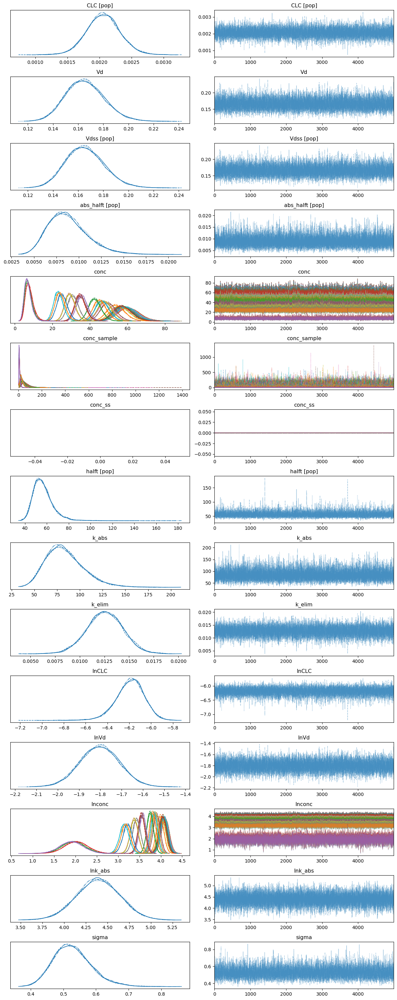

In [88]:
with pfas_female_1cmpt_primate.model:
    az.plot_trace(pfas_female_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


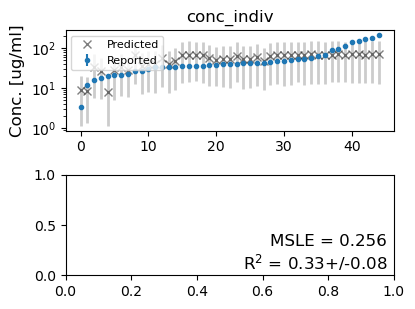

In [89]:
pfas_female_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [90]:
pfas_female_2cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.999, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=15000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxS_Female_primate_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


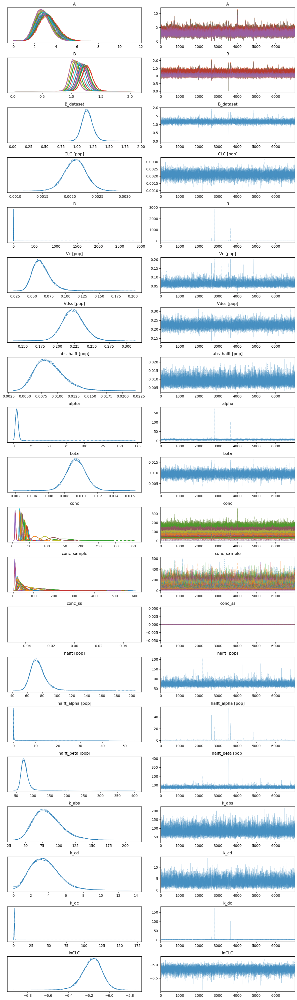

In [91]:
with pfas_female_2cmpt_primate.model:
    az.plot_trace(pfas_female_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


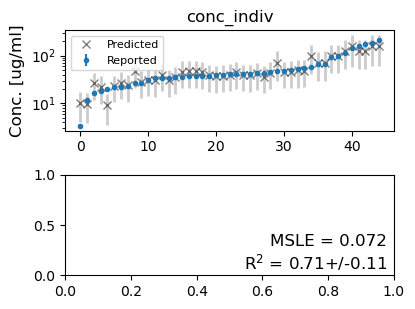

In [92]:
pfas_female_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-187.928957,12.978536,0.000000,0.919578,10.773598,0.000000,True,log
1_compartment,1,-206.422178,4.617365,18.493221,0.080422,8.548641,10.416303,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

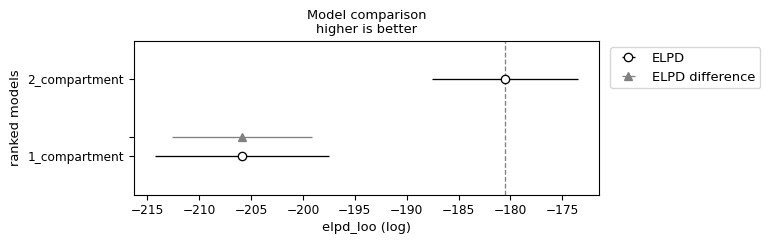

In [93]:
pfas_female_primate_compare = az.compare({"1_compartment": pfas_female_1cmpt_primate._trace, "2_compartment": pfas_female_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_female_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [94]:
pfas_female_primate = pfas_female_2cmpt_primate
print(pfas_female_primate.N_divergences)

0


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


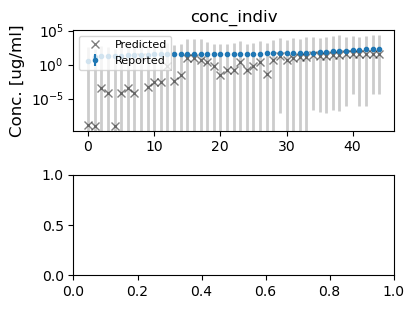

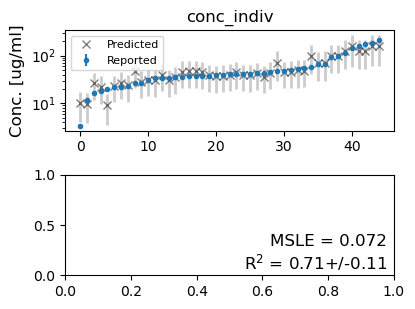

In [95]:
pfas_female_primate.plot_data_ppc(group='prior', savefig=True)
pfas_female_primate.plot_data_ppc(group='posterior', savefig=True)

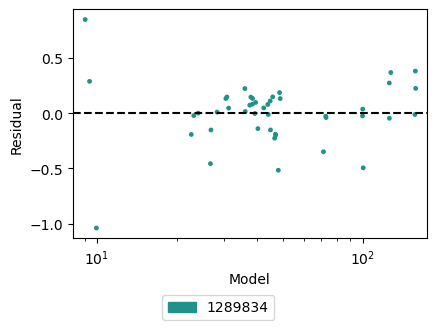

In [96]:
pfas_female_primate.plot_residuals() 

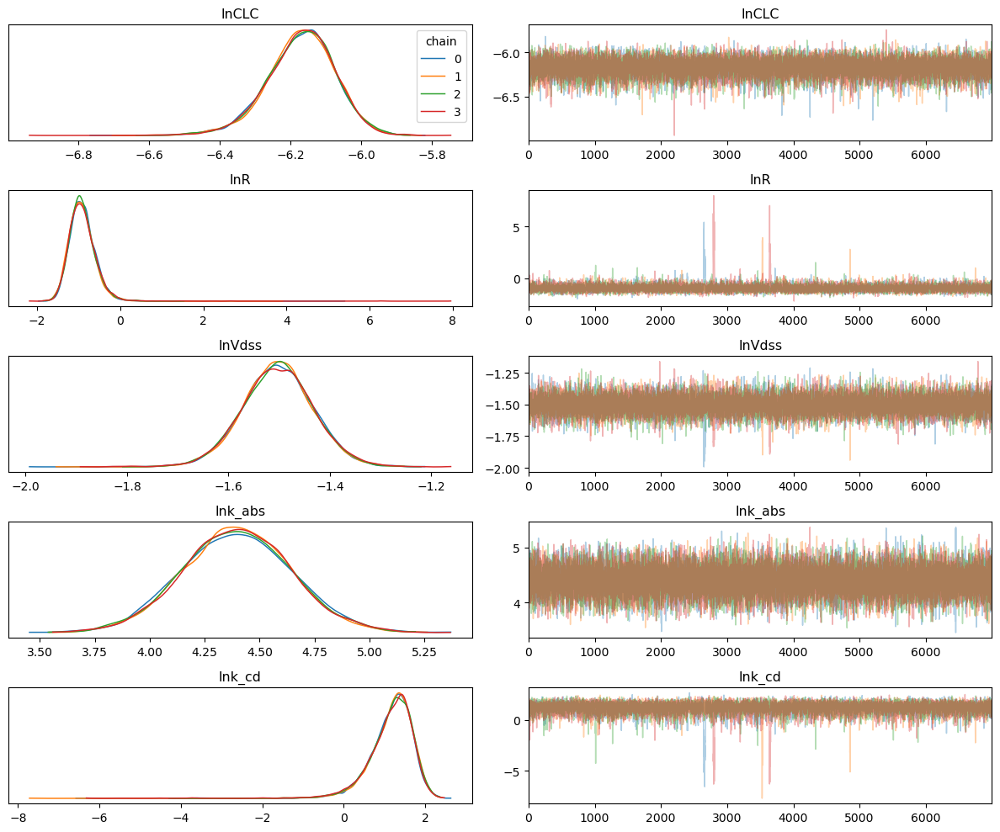

In [97]:
trace_model = pfas_female_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFHxS/PFHxS_Female_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


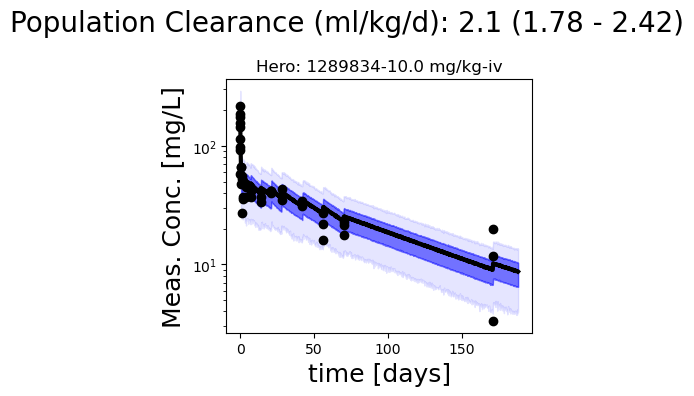

In [98]:
pfas_female_primate.plot_all_studies()

### PK stats

In [99]:
pfas_female_primate.get_pk_stats(vol_units='ml')

,mean,sd,hdi_5%,hdi_95%
CLC [pop],2.10000,0.20000,1.78000,2.42000
Vc [pop],0.06449,0.01404,0.04429,0.08523
Vdss [pop],222.93000,15.78000,197.94000,249.02000
abs_halft [pop],0.00881,0.00220,0.00524,0.01219
halft [pop],74.37645,9.72865,59.08024,88.91603
halft_alpha [pop],0.18644,0.63975,0.06624,0.27555
halft_beta [pop],74.79621,9.98740,59.46196,89.41088
